## Inverse Cooking: Recipe Generation from Food Images

In [1]:
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import numpy as np
import os
from args import get_parser
import pickle
from model import get_model
from torchvision import transforms
from utils.output_utils import prepare_output
from PIL import Image
import time

/home/donghee/anaconda3/envs/inversecooking_py37/lib/python3.7/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Set ```data_dir``` to the path including vocabularies and model checkpoint

In [2]:
data_dir = '../data'

In [3]:
# code will run in gpu if available and if the flag is set to True, else it will run on cpu
use_gpu = True
device = torch.device('cuda' if torch.cuda.is_available() and use_gpu else 'cpu')
map_loc = None if torch.cuda.is_available() and use_gpu else 'cpu'

In [4]:
# code below was used to save vocab files so that they can be loaded without Vocabulary class
#ingrs_vocab = pickle.load(open(os.path.join(data_dir, 'final_recipe1m_vocab_ingrs.pkl'), 'rb'))
#ingrs_vocab = [min(w, key=len) if not isinstance(w, str) else w for w in ingrs_vocab.idx2word.values()]
#vocab = pickle.load(open(os.path.join(data_dir, 'final_recipe1m_vocab_toks.pkl'), 'rb')).idx2word
#pickle.dump(ingrs_vocab, open('../demo/ingr_vocab.pkl', 'wb'))
#pickle.dump(vocab, open('../demo/instr_vocab.pkl', 'wb'))

ingrs_vocab = pickle.load(open(os.path.join(data_dir, 'ingr_vocab.pkl'), 'rb'))
vocab = pickle.load(open(os.path.join(data_dir, 'instr_vocab.pkl'), 'rb'))

ingr_vocab_size = len(ingrs_vocab)
instrs_vocab_size = len(vocab)
output_dim = instrs_vocab_size

In [5]:
print (instrs_vocab_size, ingr_vocab_size) ## #of ingr voca = 1488

23231 1488


In [6]:
t = time.time()
import sys; sys.argv=['']; del sys
args = get_parser()
args.maxseqlen = 15
args.ingrs_only=True ## 여기 True
model = get_model(args, ingr_vocab_size, instrs_vocab_size)
# Load the trained model parameters
model_path = os.path.join(data_dir, 'modelbest.ckpt')
model.load_state_dict(torch.load(model_path, map_location=map_loc))
model.to(device)
model.eval()
model.ingrs_only = True ## True
model.recipe_only = False
print ('loaded model')
print ("Elapsed time:", time.time() -t)


/home/donghee/anaconda3/envs/inversecooking_py37/lib/python3.7/site-packages/torch/nn/_reduction.py:44: UserWarning: size_average and reduce args will be deprecated, please use reduction='none' instead.
  warnings.warn(warning.format(ret))


loaded model
Elapsed time: 3.1875407695770264


In [7]:
transf_list_batch = []
transf_list_batch.append(transforms.ToTensor())
transf_list_batch.append(transforms.Normalize((0.485, 0.456, 0.406), 
                                              (0.229, 0.224, 0.225)))
to_input_transf = transforms.Compose(transf_list_batch)

In [8]:
greedy = [True, False, False, False]
beam = [-1, -1, -1, -1]
temperature = 1.0
numgens = len(greedy)

Set ```use_urls = True``` to get recipes for images in ```demo_urls```. 

You can also set ```use_urls = False``` and get recipes for images in the path in ```data_dir/test_imgs```.

In [9]:
import requests
from io import BytesIO
import random
from collections import Counter
use_urls = False # set to true to load images from demo_urls instead of those in test_imgs folder
show_anyways = False #if True, it will show the recipe even if it's not valid
# image_folder = os.path.join(data_dir, 'demo_imgs')
image_folder = '/home/donghee/im2recipe-Pytorch/snapme_mydb'

if not use_urls:
    demo_imgs = os.listdir(image_folder)
    random.shuffle(demo_imgs)

demo_urls = ['https://food.fnr.sndimg.com/content/dam/images/food/fullset/2013/12/9/0/FNK_Cheesecake_s4x3.jpg.rend.hgtvcom.826.620.suffix/1387411272847.jpeg',
            'https://www.196flavors.com/wp-content/uploads/2014/10/california-roll-3-FP.jpg']

demo_files = demo_urls if use_urls else demo_imgs

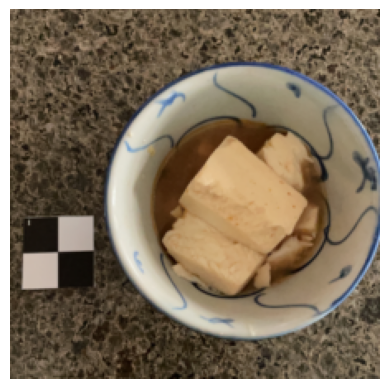


Ingredients:
Ground Truth:  ['Soy sauce', 'Soybean curd']
Inversecooking Prediction:  sugar, water, soy_sauce
im2recipe Prediction:  Cucumber pickles (replaced with ['pickle'])
======== 0 th iteration====


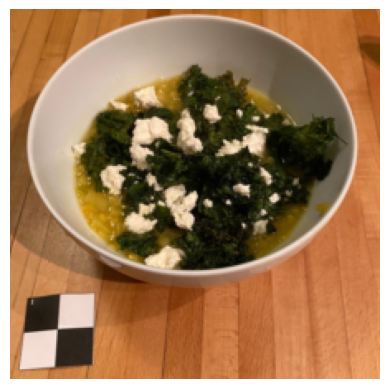


Ingredients:
Ground Truth:  ['Lentil soup', 'Kale']
Inversecooking Prediction:  cheese, oil, pepper, kale, clove, onion, salt
im2recipe Prediction:  Sunflower seeds, Brussels sprouts, Tomatoes, Spinach, Cabbage, Avocado, Lemon juice


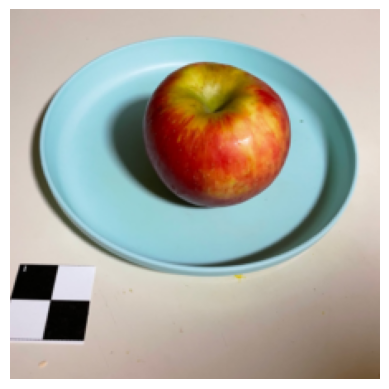


Ingredients:
Ground Truth:  ['Apple']
Inversecooking Prediction:  cinnamon, apple, sugar, butter
im2recipe Prediction:  Plantain, Cabbage salad or coleslaw (replaced with ['coleslaw'])


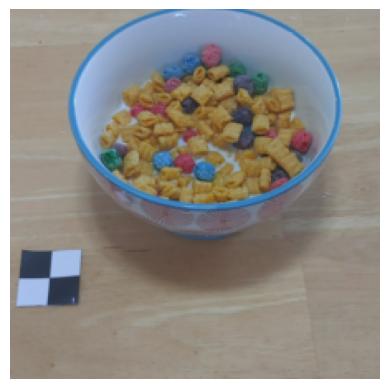


Ingredients:
Ground Truth:  ["Cereal (Quaker Cap'n Crunch's Crunchberries)", 'Milk']
Inversecooking Prediction:  butter, cereal, marshmallow, sugar
im2recipe Prediction:  Trail mix with chocolate (replaced with ['chocolate', 'trail_mix'])


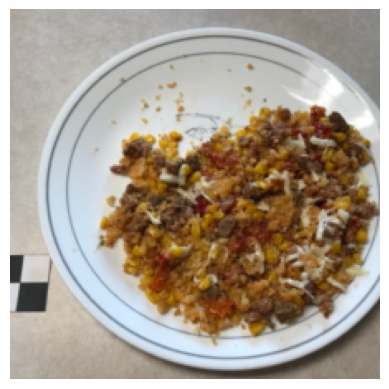


Ingredients:
Ground Truth:  ['Corn', 'Cornmeal mush', 'Tomatoes', 'Cheese', 'Italian sausage']
Inversecooking Prediction:  corn, pepper, onion, rice, salt, quinoa, oil
im2recipe Prediction:  Black, Cheese, Burrito with chicken and beans (replaced with ['burrito', 'chicken', 'beans']), Spanish rice, Onions, Salsa, Tortilla chips, Queso cotija (replaced with ['Cotija_cheese'])


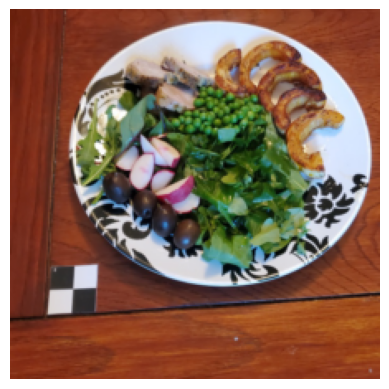


Ingredients:
Ground Truth:  ['Butter', 'Radish', 'Olive oil', 'Pork roast', 'Mixed salad greens', 'Olives', 'Squash', 'Peas']
Inversecooking Prediction:  oil, onion, vinegar, soy_sauce, pepper, greens, clove
im2recipe Prediction:  Chicken breast, Tomatoes, Cheese, Brussels sprouts, Mixed salad greens, Onions, Carrots, Italian dressing


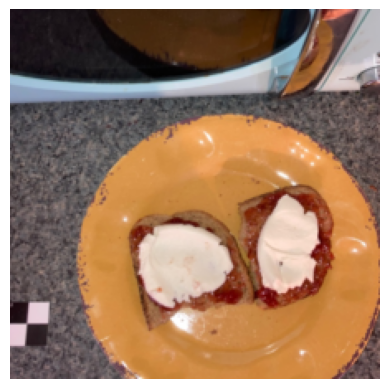


Ingredients:
Ground Truth:  ['Bread', 'Jam', 'Cheese']
Inversecooking Prediction:  cream, marshmallow, sugar
im2recipe Prediction:  Turkey or chicken sausage (replaced with ['chicken_sausages']), Maple syrup, French toast (replaced with ['toast'])


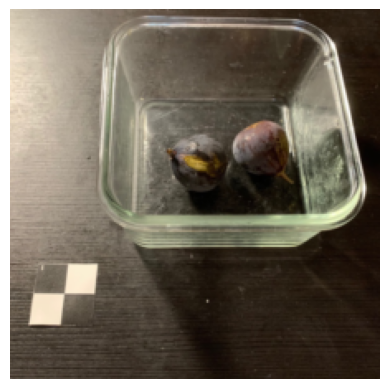


Ingredients:
Ground Truth:  ['Fig']
Inversecooking Prediction:  soy_sauce, clove
im2recipe Prediction:  Carbonated water, Cranberry juice


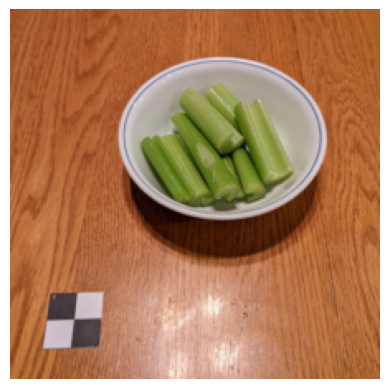


Ingredients:
Ground Truth:  ['Celery']
Inversecooking Prediction:  cucumber, butter, salt
im2recipe Prediction:  Pork and vegetables including carrots (replaced with ['pork', 'vegetables']), Rice


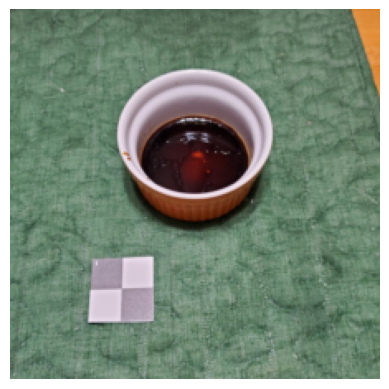


Ingredients:
Ground Truth:  ['Vinegar', 'Sesame oil', 'Soy sauce']
Inversecooking Prediction:  water, soy_sauce, sugar
im2recipe Prediction:  Cranberry juice drink, Carbonated water


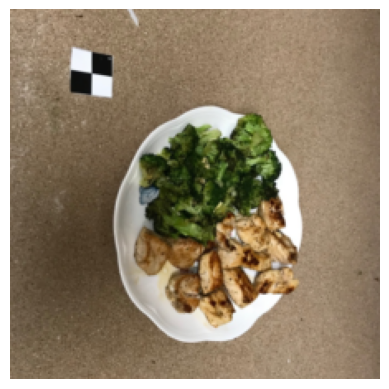


Ingredients:
Ground Truth:  ['Broccoli', 'Chicken breast']
Inversecooking Prediction:  oil, pepper, salt, mushroom, butter, clove
im2recipe Prediction:  Brussels sprouts, Avocado, Rice, Chicken breast, Soy sauce
======== 10 th iteration====


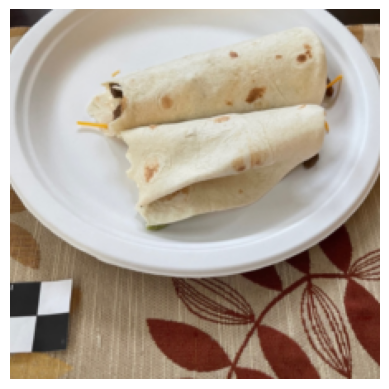


Ingredients:
Ground Truth:  ['Sour cream', 'Guacamole', 'Cheese', 'Peppers', 'Onions', 'Tortilla', 'Beef steak']
Inversecooking Prediction:  sugar, flour, butter, cheese, milk, salt, egg
im2recipe Prediction:  Refried beans, Salsa, Lettuce, Guacamole, Cheese, Avocado, Salsa verde or salsa (replaced with ['salsa_verde']), Tortilla, Sour cream


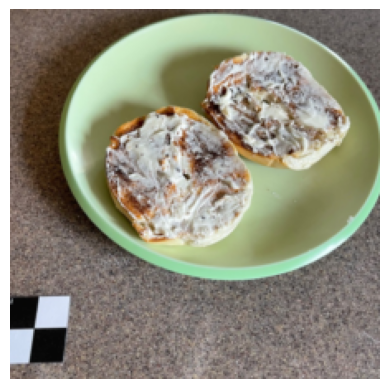


Ingredients:
Ground Truth:  ['Bagel', 'Cheese']
Inversecooking Prediction:  sugar, egg, coconut, cheese, milk, salt, butter, cinnamon, flour
im2recipe Prediction:  Ice cream, Topping


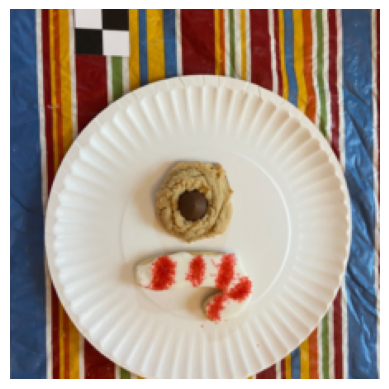


Ingredients:
Ground Truth:  ['Milk chocolate candy', 'Cookie', 'Candy']
Inversecooking Prediction:  sugar, flour, egg, salt, butter, chips, extract, baking_powder, milk
im2recipe Prediction:  Crackers, Broccoli cheese soup (replaced with ['Broccoli', 'cheese_soup'])


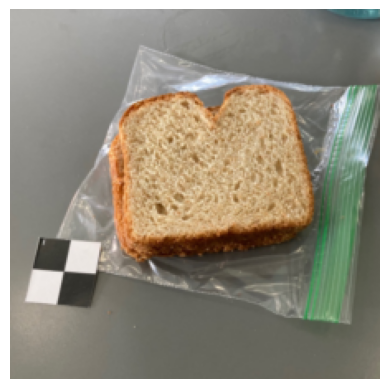


Ingredients:
Ground Truth:  ['Bread', 'Jelly', 'Peanut butter']
Inversecooking Prediction:  sugar, flour, egg, salt, butter, banana, baking_powder, milk
im2recipe Prediction:  Pasta with tomato-based sauce (replaced with ['tomato_paste']), Water, Garlic bread


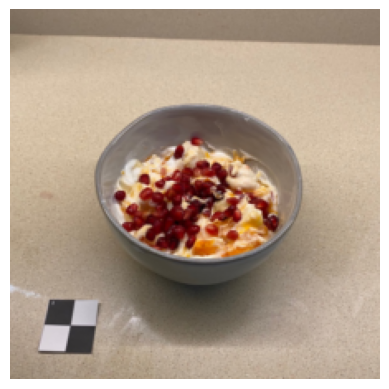


Ingredients:
Ground Truth:  ['Banana', 'Yogurt', 'Persimmon', 'Pomegranate']
Inversecooking Prediction:  bacon, cream, milk, cheese
im2recipe Prediction:  Red beans and rice (replaced with ['red_beans', 'rice']), Tomatoes


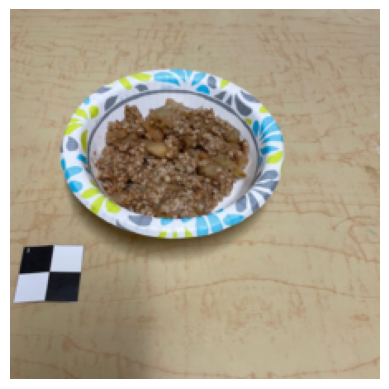


Ingredients:
Ground Truth:  ['Apple', 'Oats']
Inversecooking Prediction:  sugar, butter, salt
im2recipe Prediction:  Potato chips, Ground beef


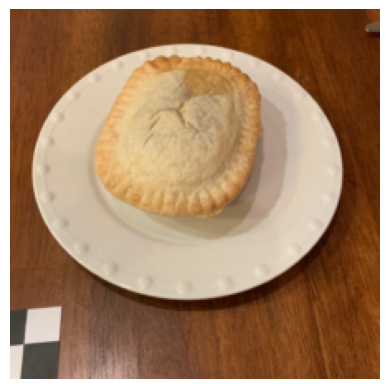


Ingredients:
Ground Truth:  ['Beef pot pie']
Inversecooking Prediction:  egg, flour, butter, salt, milk, sugar
im2recipe Prediction:  Ravioli, Mixed vegetables, Cheese sauce


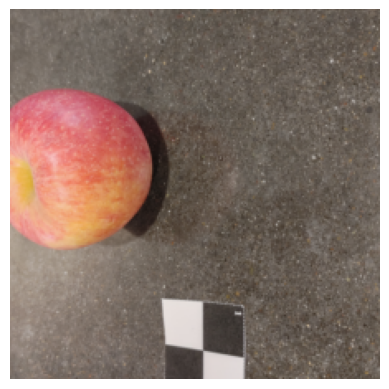


Ingredients:
Ground Truth:  ['Apple']
Inversecooking Prediction:  onion, sugar, salt
im2recipe Prediction:  Banana, Tangerine


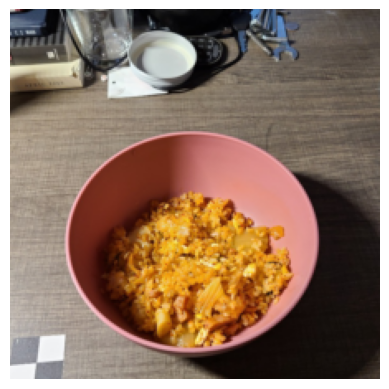


Ingredients:
Ground Truth:  ['Water', 'Rice', 'Kimchi']
Inversecooking Prediction:  oil, rice, onion, water, salt, soy_sauce, pepper, curry, clove
im2recipe Prediction:  Burrito with beans and rice (replaced with ['burrito', 'beans', 'rice']), Sour cream, Salsa


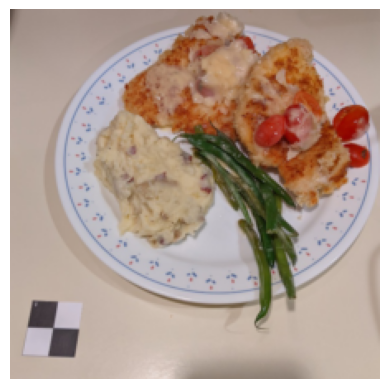


Ingredients:
Ground Truth:  ['Tomatoes', 'Cheese', 'Beans', 'Chicken breast', 'Potato']
Inversecooking Prediction:  tomato, cheese, chicken, pepper, asparagus, butter, oil
im2recipe Prediction:  Lettuce, Soy sauce, Rice, Chicken breast, Pepper, Oyster-flavored sauce, Garlic
======== 20 th iteration====


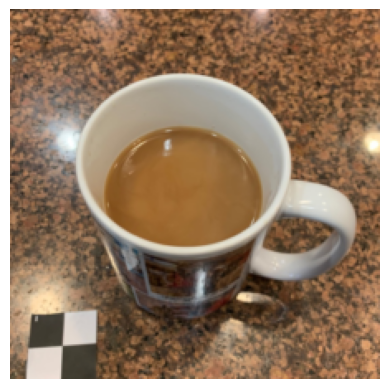


Ingredients:
Ground Truth:  ['Coffee', 'Milk']
Inversecooking Prediction:  water, coffee, sugar, tea
im2recipe Prediction:  Cereal, Almond milk


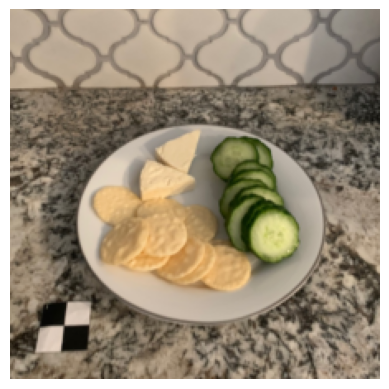


Ingredients:
Ground Truth:  ['Crackers', 'Cheese spread', 'Cucumber']
Inversecooking Prediction:  cucumber, cheese, onion, pepper, mayonnaise, salt
im2recipe Prediction:  Water, Tangerine


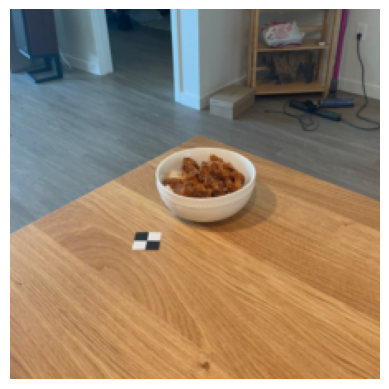


Ingredients:
Ground Truth:  ['Chicken or turkey and rice with tomato-based sauce']
Inversecooking Prediction:  seeds, butter, cinnamon
im2recipe Prediction:  Potato chips, Ground beef


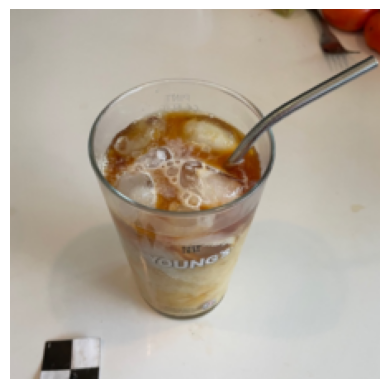


Ingredients:
Ground Truth:  ['Cream', 'Iced Coffee']
Inversecooking Prediction:  sugar, water, coffee, cinnamon
im2recipe Prediction:  Carbonated water, Cranberry juice


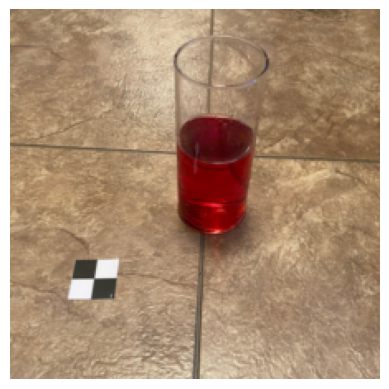


Ingredients:
Ground Truth:  ['Cranberry juice drink', 'Carbonated water']
Inversecooking Prediction:  water, juice, ice
im2recipe Prediction:  Cranberry juice drink, Carbonated water


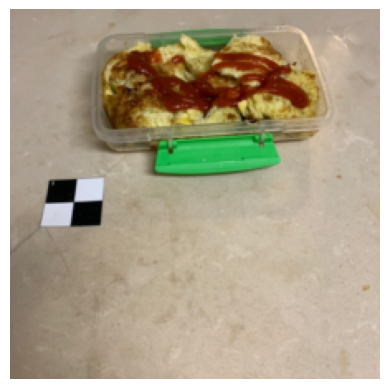


Ingredients:
Ground Truth:  ['Egg white omelet', 'Egg omelet or scrambled egg', 'Tomato catsup']
Inversecooking Prediction:  sugar, butter
im2recipe Prediction:  Pasta with tomato-based sauce (replaced with ['tomato_paste']), Alfredo sauce, Spaghetti sauce, Chicken breast


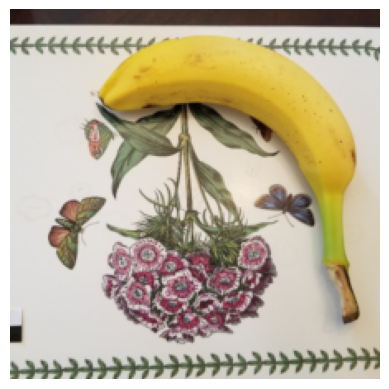


Ingredients:
Ground Truth:  ['Banana']
Inversecooking Prediction:  sugar, egg, butter, cream, milk
im2recipe Prediction:  Ice cream cone


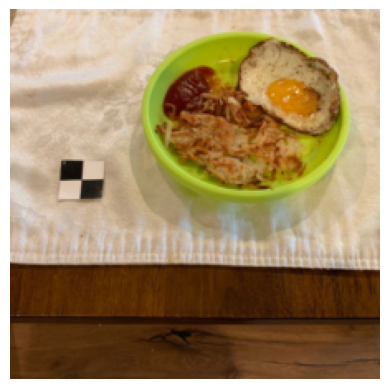


Ingredients:
Ground Truth:  ['Potato', 'Egg', 'Tomato catsup']
Inversecooking Prediction:  rice, onion, pepper, egg, mayonnaise, salt
im2recipe Prediction:  Tuna salad, Teriyaki sauce, Vegetables, Vinegar, Bread, Soy sauce


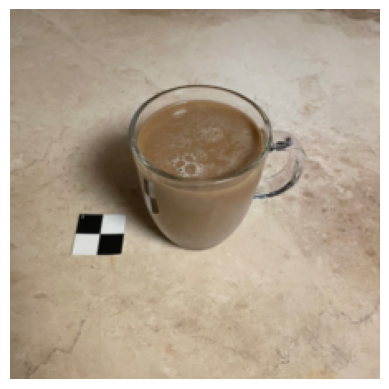


Ingredients:
Ground Truth:  ['Coffee creamer', 'Coffee']
Inversecooking Prediction:  milk, banana, cocoa, sugar
im2recipe Prediction:  Cranberry juice drink, Carbonated water


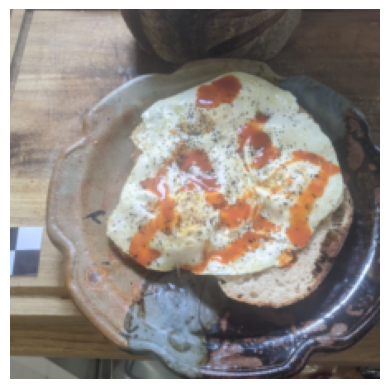


Ingredients:
Ground Truth:  ['Bread', 'Egg', 'Salsa']
Inversecooking Prediction:  cheese, bread, salt
im2recipe Prediction:  Tomatoes, Cheese, Roll, Romaine lettuce, Tomato catsup
======== 30 th iteration====


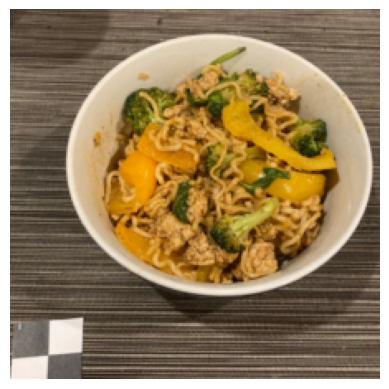


Ingredients:
Ground Truth:  ['Peppers', 'Broccoli', 'Spinach', 'Soup', 'Turkey']
Inversecooking Prediction:  oil, soy_sauce, pepper, chicken, clove, onion, ginger, water, broth
im2recipe Prediction:  Noodles, Chicken or turkey and noodles (replaced with ['chicken', 'noodles']), Creamy dressing (replaced with ['dressing'])


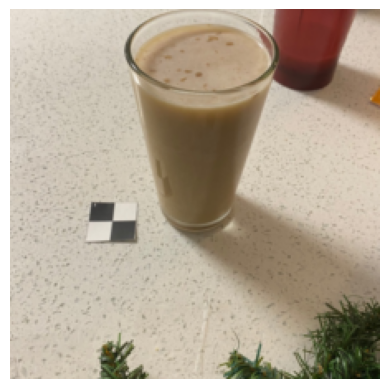


Ingredients:
Ground Truth:  ['Nutritional powder mix', 'Water']
Inversecooking Prediction:  banana, ice, water
im2recipe Prediction:  Cranberry juice drink, Carbonated water


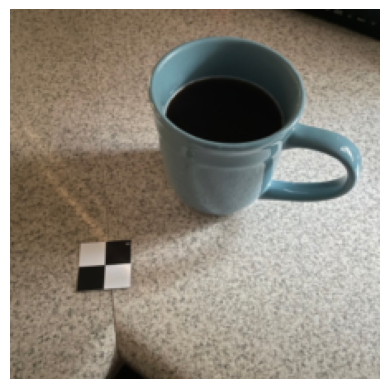


Ingredients:
Ground Truth:  ['Coffee']
Inversecooking Prediction:  sugar, water, coffee
im2recipe Prediction:  Carbonated water, Cranberry juice


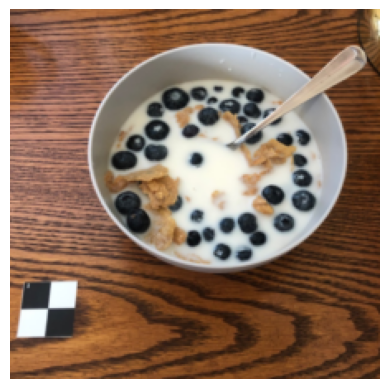


Ingredients:
Ground Truth:  ['Blueberries', "Cereal (Kellogg's All-Bran Complete Wheat Flakes)", 'Almond milk']
Inversecooking Prediction:  blueberries, sugar, butter, banana, milk, extract
im2recipe Prediction:  Ice cream, Topping


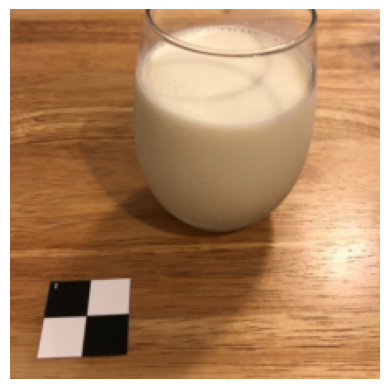


Ingredients:
Ground Truth:  ['Milk']
Inversecooking Prediction:  water, sugar, milk, salt
im2recipe Prediction:  Cereal, Almond milk


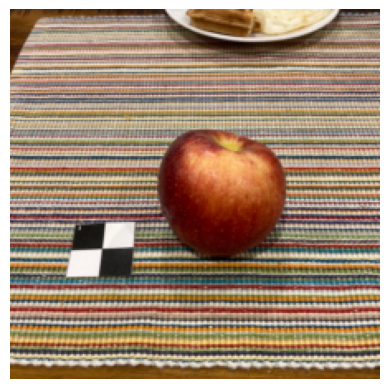


Ingredients:
Ground Truth:  ['Apple']
Inversecooking Prediction:  apple, cinnamon, pear, sugar, butter
im2recipe Prediction:  Turkey or chicken sausage (replaced with ['chicken_sausages']), Maple syrup, French toast (replaced with ['toast'])


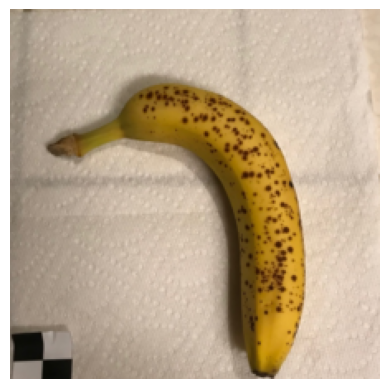


Ingredients:
Ground Truth:  ['Banana']
Inversecooking Prediction:  milk, sugar
im2recipe Prediction:  Ice cream cone


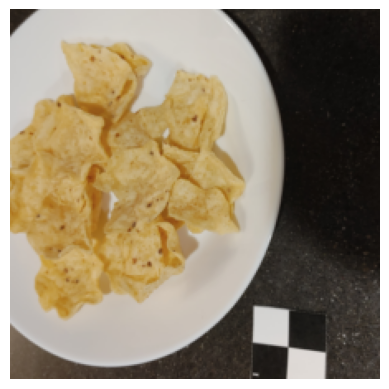


Ingredients:
Ground Truth:  ['Tortilla chips']
Inversecooking Prediction:  salt, flour, pepper, butter, cheese
im2recipe Prediction:  Macaroni or noodles with cheese (replaced with ['macaroni', 'cheese'])


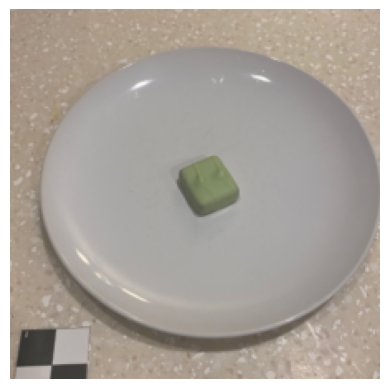


Ingredients:
Ground Truth:  ['Milk chocolate candy']
Inversecooking Prediction:  cucumber, water, salt
im2recipe Prediction:  Grapes, Pineapple, Biscuit, Honeydew melon, Cantaloupe, Egg omelet or scrambled egg (replaced with ['omelet'])


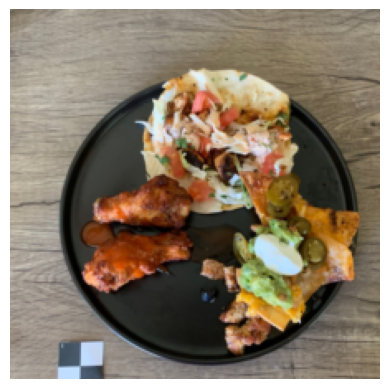


Ingredients:
Ground Truth:  ['Chicken wings with hot sauce', 'Soft taco with meat', 'Guacamole with tomatoes', 'Creamy dressing', 'Nachos with chicken']
Inversecooking Prediction:  salt, oil, chicken, pepper, onion
im2recipe Prediction:  Refried beans, Salsa, Lettuce, Guacamole, Cheese, Avocado, Salsa verde or salsa (replaced with ['salsa_verde']), Tortilla, Sour cream
======== 40 th iteration====


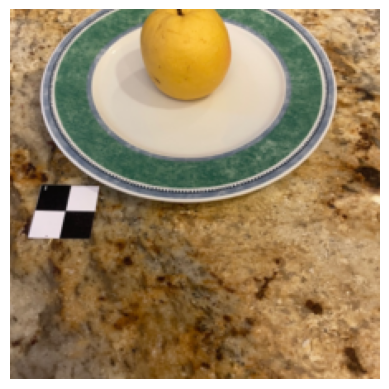


Ingredients:
Ground Truth:  ['Pear']
Inversecooking Prediction:  sugar, egg, salt, flour, pepper, butter
im2recipe Prediction:  Banana, Yogurt, Raspberries, Honey


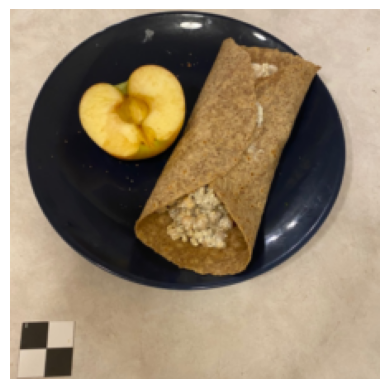


Ingredients:
Ground Truth:  ['Mustard', 'Peanut butter', 'Apple', 'Chickpeas', 'Yogurt', 'Mayonnaise', 'Tortilla']
Inversecooking Prediction:  sugar, flour, cinnamon, egg, salt, baking_powder
im2recipe Prediction:  Lettuce, Radish, Pork roast, Mushrooms, Chicken or turkey broth (replaced with ['chicken_broth']), Vegetarian burger or patty (replaced with ['veggie_burger'])


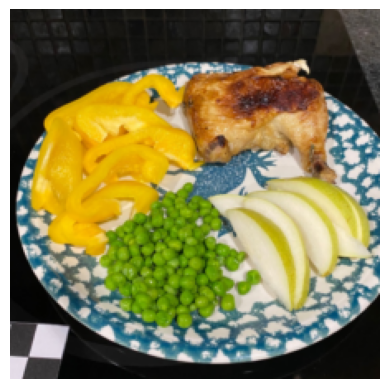


Ingredients:
Ground Truth:  ['Chicken thigh', 'Pear', 'Pepper', 'Peas']
Inversecooking Prediction:  cheese, egg, butter, pepper, breadcrumbs, salt, milk
im2recipe Prediction:  Orange, Olive oil, Egg, Avocado, Onions, Milk, Yogurt


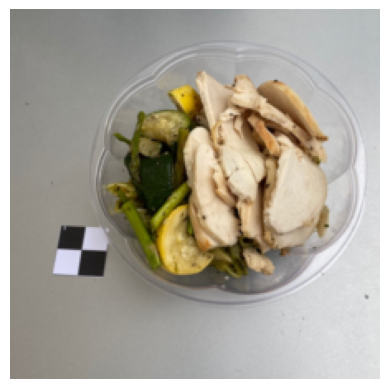


Ingredients:
Ground Truth:  ['Asparagus', 'Pesto sauce', 'Squash', 'Chicken breast', 'Pasta']
Inversecooking Prediction:  pepper, oil, zucchini, mushroom, onion, salt, squash, clove
im2recipe Prediction:  Lettuce, Soy sauce, Rice, Chicken breast, Pepper, Oyster-flavored sauce, Garlic


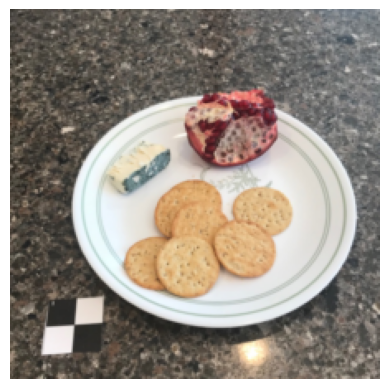


Ingredients:
Ground Truth:  ['Crackers', 'Pomegranate', 'Cheese']
Inversecooking Prediction:  cheese, onion, pepper, breadcrumbs, salt, egg, tomato
im2recipe Prediction:  Tzatziki dip, Salami, Sauerkraut, Tangerine, Carrots, Crackers, Date


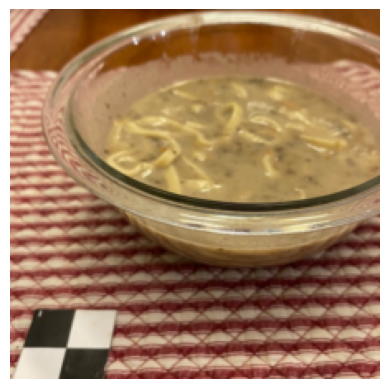


Ingredients:
Ground Truth:  ['Mushroom soup']
Inversecooking Prediction:  pepper, mayonnaise, oil, salt, vinegar, mustard, juice
im2recipe Prediction:  Water, Tangerine


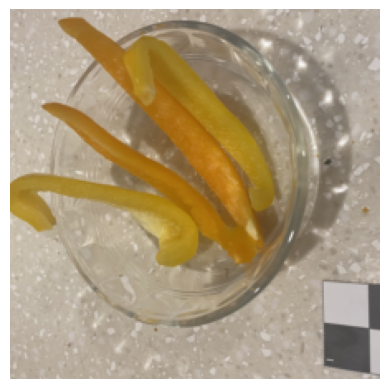


Ingredients:
Ground Truth:  ['Pepper']
Inversecooking Prediction:  water, juice, ice, lemon
im2recipe Prediction:  Carbonated water, Cranberry juice


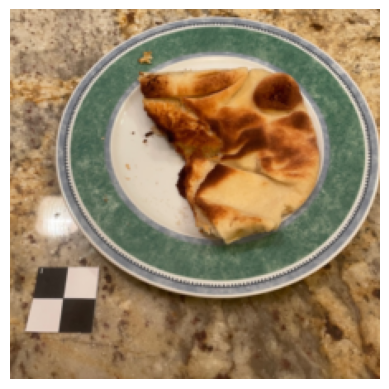


Ingredients:
Ground Truth:  ['Naan']
Inversecooking Prediction:  egg, butter, salt, flour, oil, milk
im2recipe Prediction:  Chicken or turkey soup with dumplings (replaced with ['chicken_soup', 'dumplings'])


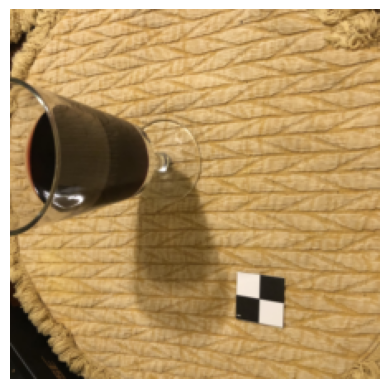


Ingredients:
Ground Truth:  ['Wine']
Inversecooking Prediction:  sugar, flour, egg, baking_soda, salt, butter, ginger, molasses, cinnamon
im2recipe Prediction:  Shrimp, Dumpling, Seaweed


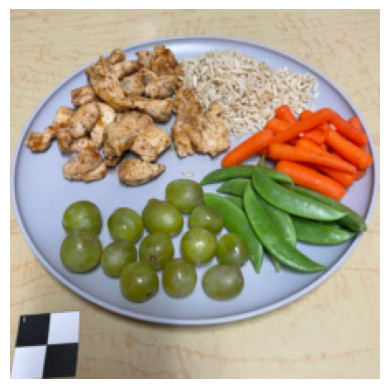


Ingredients:
Ground Truth:  ['Carrots', 'Snowpeas', 'Rice', 'Chicken breast']
Inversecooking Prediction:  chicken, pepper, salt, oil, butter, clove
im2recipe Prediction:  Nectarine, Tangerine, Tomatoes
======== 50 th iteration====


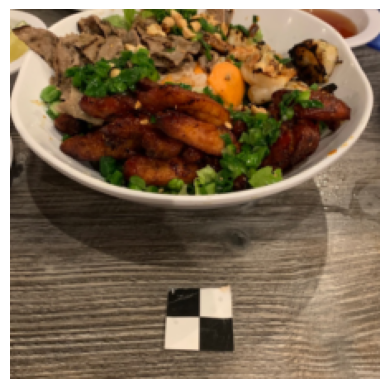


Ingredients:
Ground Truth:  ['Salad dressing', 'Peanuts', 'Chicken thigh', 'Cilantro', 'Beef with barbecue sauce', 'Onions', 'Shrimp', 'Romaine lettuce']
Inversecooking Prediction:  pepper, oil, salt, cilantro, clove, soy_sauce, parsley, onion, juice
im2recipe Prediction:  Lamb chop


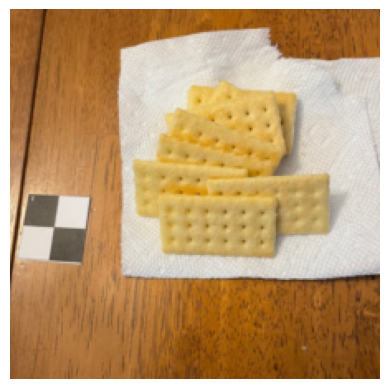


Ingredients:
Ground Truth:  ['Crackers']
Inversecooking Prediction:  cheese, egg, flour, pepper, butter, salt, milk
im2recipe Prediction:  Muffin, Butter replacement (replaced with ['butter'])


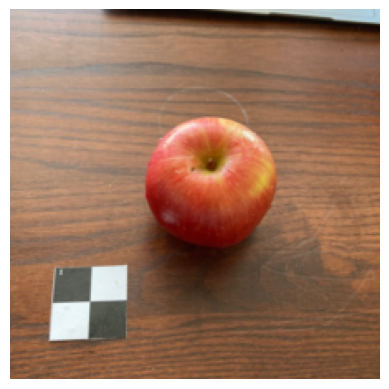


Ingredients:
Ground Truth:  ['Apple']
Inversecooking Prediction:  sugar, apple, cinnamon, butter, nutmeg
im2recipe Prediction:  Lettuce, Radish, Pork roast, Mushrooms, Chicken or turkey broth (replaced with ['chicken_broth']), Vegetarian burger or patty (replaced with ['veggie_burger'])


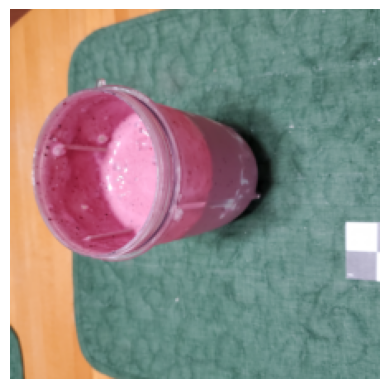


Ingredients:
Ground Truth:  ['Fruit smoothie']
Inversecooking Prediction:  milk, yogurt, blueberries, banana
im2recipe Prediction:  Carbonated water, Cranberry juice


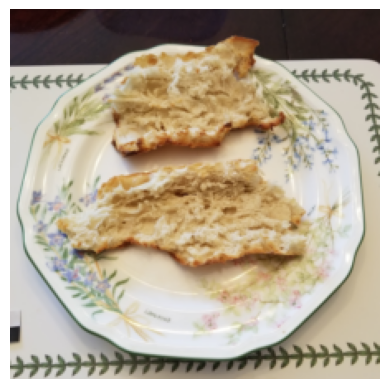


Ingredients:
Ground Truth:  ['Bread']
Inversecooking Prediction:  sugar, flour, butter, salt, baking_powder, egg, almonds, extract
im2recipe Prediction:  Chicken patty, Roll, Butter, Cheese


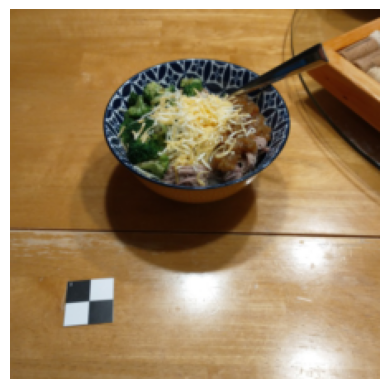


Ingredients:
Ground Truth:  ['Cheese', 'Broccoli', 'Pork', 'Rice', 'Onions', 'Salsa']
Inversecooking Prediction:  cheese, lettuce, onion, cream, beef, pepper, tomato, water, beans, salt
im2recipe Prediction:  White beans, Cheese, Onions, Chicken or turkey broth (replaced with ['chicken_broth']), Garlic


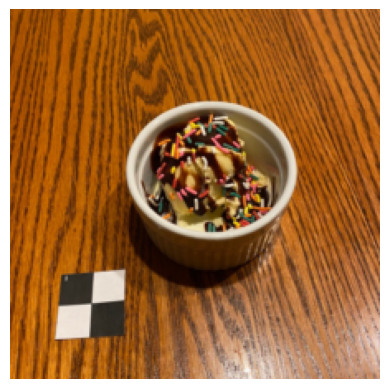


Ingredients:
Ground Truth:  ['Chocolate syrup', 'Chocolate-flavored sprinkles', 'Ice cream']
Inversecooking Prediction:  sugar, milk, seeds
im2recipe Prediction:  Radish, Italian dressing, Lettuce


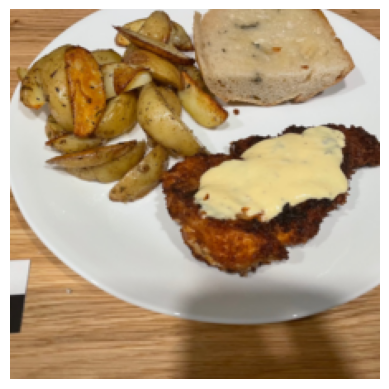


Ingredients:
Ground Truth:  ['Butter', 'Chicken fillet', 'Honey mustard dip', 'Olive oil', 'Bread', 'Potato']
Inversecooking Prediction:  oil, pepper, potato, salt, egg, flour, clove, breadcrumbs
im2recipe Prediction:  Lamb chop


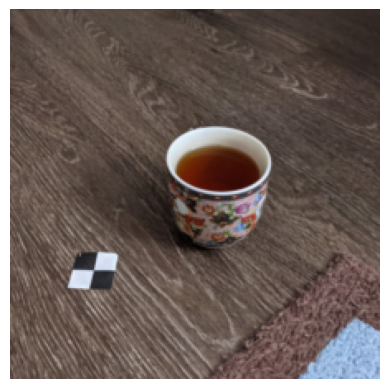


Ingredients:
Ground Truth:  ['Tea']
Inversecooking Prediction:  water, sugar, coffee
im2recipe Prediction:  Carbonated water, Cranberry juice


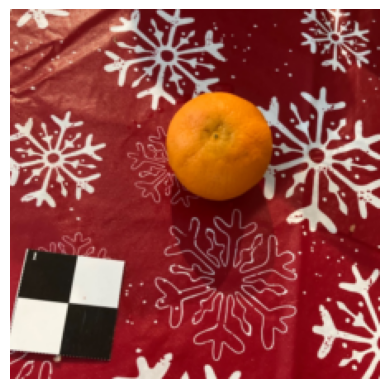


Ingredients:
Ground Truth:  ['Tangerine']
Inversecooking Prediction:  sugar, egg, butter, flour, cheese, baking_powder, salt, milk
im2recipe Prediction:  Carbonated water, Cranberry juice
======== 60 th iteration====


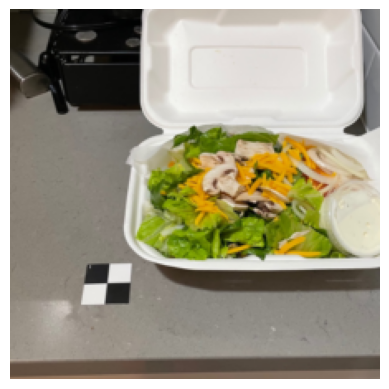


Ingredients:
Ground Truth:  ['Tomatoes', 'Cheese', 'Onions', 'Mushrooms', 'Creamy dressing', 'Romaine lettuce']
Inversecooking Prediction:  cheese, lettuce, tomato, cream, onion, olive, chicken, pepper
im2recipe Prediction:  Cucumber, Croutons, Tomatoes, Mixed salad greens, Chicken, Italian dressing, Romaine lettuce


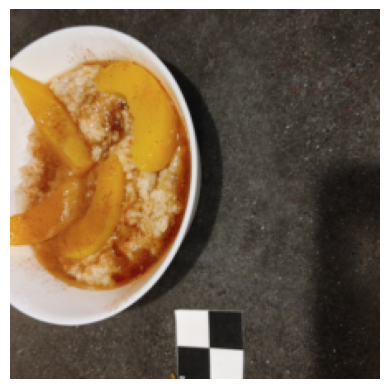


Ingredients:
Ground Truth:  ['Maple syrup', 'Oatmeal', 'Peach']
Inversecooking Prediction:  sugar, cinnamon, butter, juice, peach, water, apple
im2recipe Prediction:  Plantain, Cabbage salad or coleslaw (replaced with ['coleslaw'])


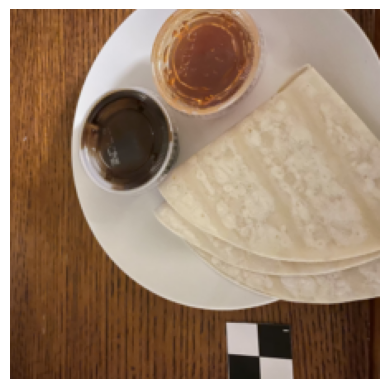


Ingredients:
Ground Truth:  ['Sweet and sour sauce', 'Tortilla']
Inversecooking Prediction:  salt, butter, sugar
im2recipe Prediction:  Cereal, Almond milk


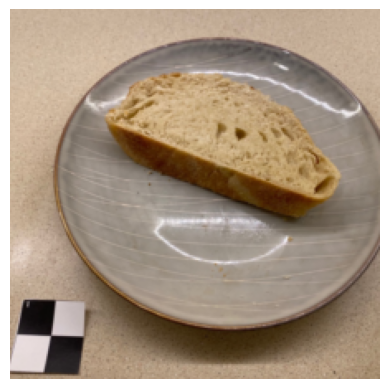


Ingredients:
Ground Truth:  ['Bread', 'Butter']
Inversecooking Prediction:  sugar, flour, butter, salt, yeast, oil, egg, milk
im2recipe Prediction:  Pasta with tomato-based sauce (replaced with ['tomato_paste']), Water, Garlic bread


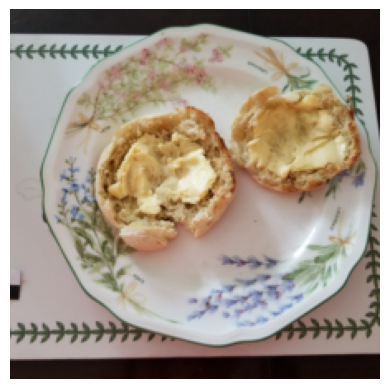


Ingredients:
Ground Truth:  ['Muffin', 'Butter']
Inversecooking Prediction:  egg, butter, cheese, onion, pepper
im2recipe Prediction:  Water, Croissant


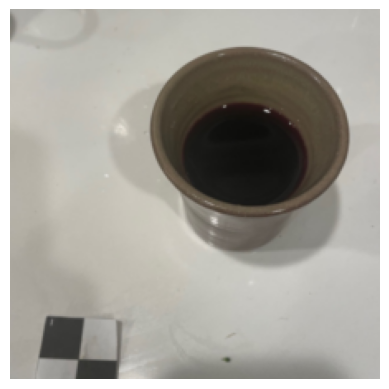


Ingredients:
Ground Truth:  ['Wine']
Inversecooking Prediction:  water, sugar, coffee
im2recipe Prediction:  Cranberry juice drink, Carbonated water


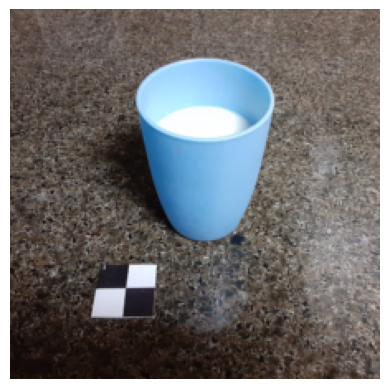


Ingredients:
Ground Truth:  ['Milk']
Inversecooking Prediction:  water, curacao, ice, sugar
im2recipe Prediction:  Cranberry juice drink, Carbonated water


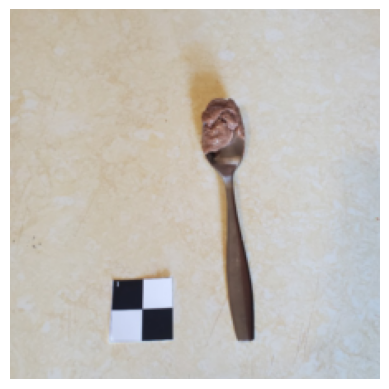


Ingredients:
Ground Truth:  ['Almond butter']
Inversecooking Prediction:  salt, flour, water
im2recipe Prediction:  Catfish, Rice, Tomatoes


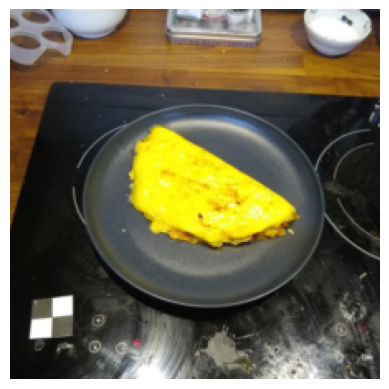


Ingredients:
Ground Truth:  ['Olive oil', 'Cheese', 'Peppers', 'Onions', 'Egg omelet or scrambled egg']
Inversecooking Prediction:  egg, cheese, milk, pepper, butter, salt
im2recipe Prediction:  Kiwi fruit


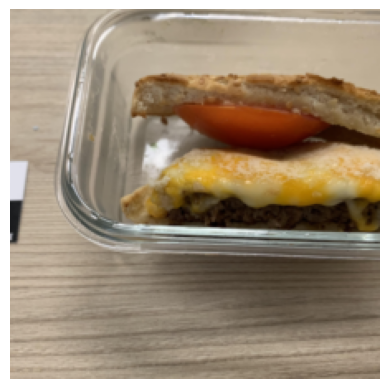


Ingredients:
Ground Truth:  ['Tomatoes', 'Cheese', 'Roll', 'Romaine lettuce', 'Tomato catsup']
Inversecooking Prediction:  egg, cheese, tomato, pepper, bread, salt, onion
im2recipe Prediction:  Water, Croissant
======== 70 th iteration====


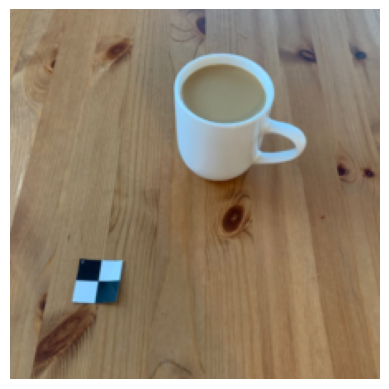


Ingredients:
Ground Truth:  ['Coffee creamer', 'Coffee']
Inversecooking Prediction:  water, milk, sugar
im2recipe Prediction:  Cereal, Almond milk


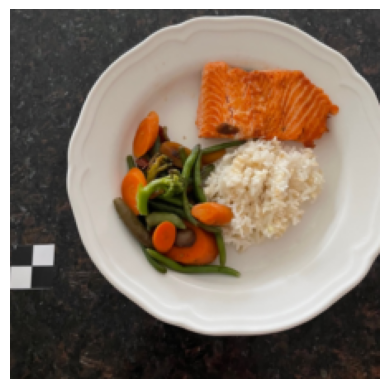


Ingredients:
Ground Truth:  ['Salmon', 'Rice', 'Vegetable combination']
Inversecooking Prediction:  rice, salt, fillets, pepper, milk, oil
im2recipe Prediction:  Butter, Lettuce, Pork chop, Celery, Bread, Onions, Chickpeas, Pepper, Romaine lettuce, Italian dressing


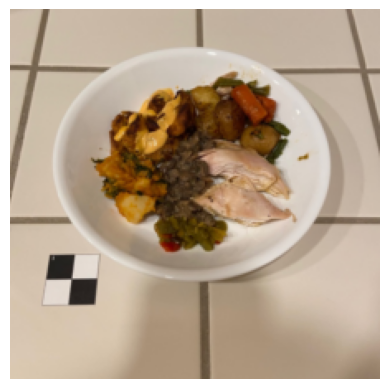


Ingredients:
Ground Truth:  ['Gravy', 'Peppers', 'Chicken breast', 'Potato', 'Chicken or turkey and vegetables including carrots']
Inversecooking Prediction:  carrot, onion, pepper, oil, potato, salt, broth, clove, thyme, water
im2recipe Prediction:  Lamb chop


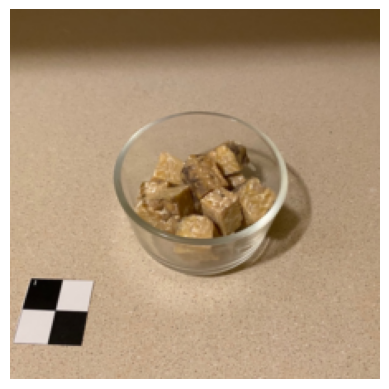


Ingredients:
Ground Truth:  ['Vegetarian burger or patty']
Inversecooking Prediction:  sugar, butter, milk, seeds
im2recipe Prediction:  Pumpkin seeds


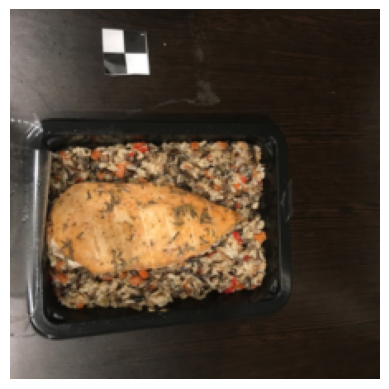


Ingredients:
Ground Truth:  ['Chicken or turkey']
Inversecooking Prediction:  chicken, pepper, rice, carrot, onion, salt
im2recipe Prediction:  Lettuce, Soy sauce, Rice, Chicken breast, Pepper, Oyster-flavored sauce, Garlic


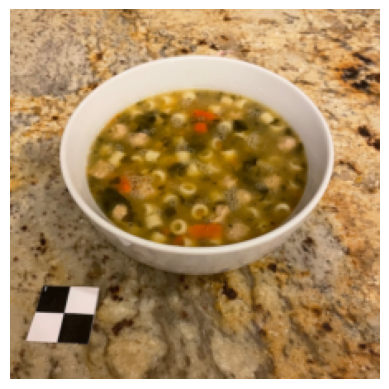


Ingredients:
Ground Truth:  ['Italian Wedding Soup']
Inversecooking Prediction:  carrot, onion, pepper, peas, salt, lentils, celery, broth, clove, thyme, parsley
im2recipe Prediction:  Chicken breast, Corn, White beans, Red kidney beans, Peppers, Onions, Chicken or turkey broth (replaced with ['chicken_broth']), Garlic


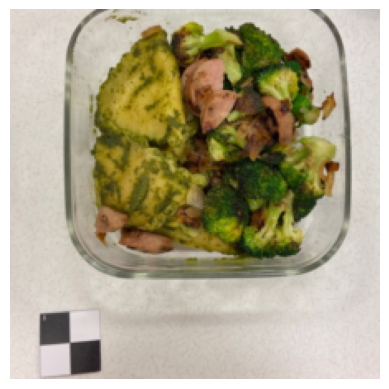


Ingredients:
Ground Truth:  ['Ravioli', 'Onions', 'Turkey or chicken sausage', 'Broccoli']
Inversecooking Prediction:  pepper, broccoli, chicken, salt, oil, butter, clove
im2recipe Prediction:  Sunflower seeds, Brussels sprouts, Tomatoes, Spinach, Cabbage, Avocado, Lemon juice


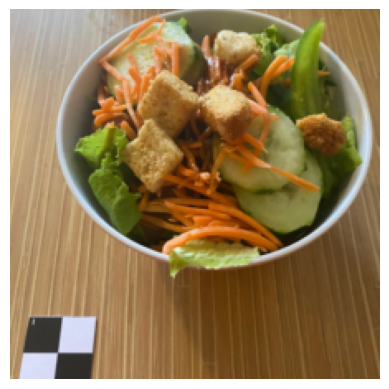


Ingredients:
Ground Truth:  ['Water', 'Red kidney beans', 'Croutons', 'Egg', 'Tomatoes', 'Mixed salad greens', 'Carrots', 'Pepper', 'Romaine lettuce', 'Sesame dressing']
Inversecooking Prediction:  lettuce, carrot, chicken, cucumber, soy_sauce, oil
im2recipe Prediction:  Caesar dressing, Lettuce, Croutons, Cheese, Romaine lettuce


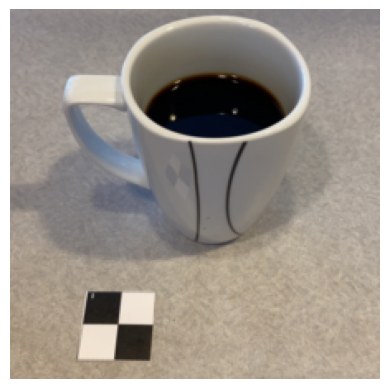


Ingredients:
Ground Truth:  ['Coffee']
Inversecooking Prediction:  sugar, water, coffee
im2recipe Prediction:  Cranberry juice drink, Carbonated water


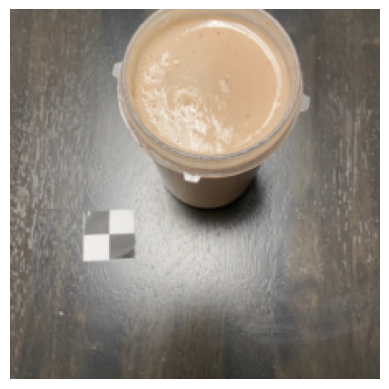


Ingredients:
Ground Truth:  ['Fruit smoothie']
Inversecooking Prediction:  milk, banana, ice, syrup
im2recipe Prediction:  Cereal, Almond milk
======== 80 th iteration====


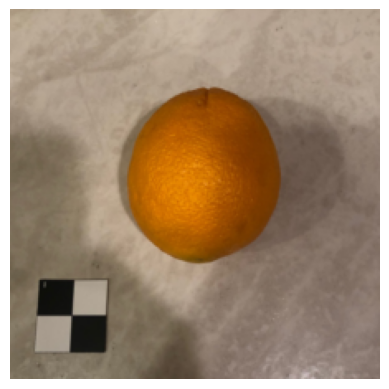


Ingredients:
Ground Truth:  ['Orange']
Inversecooking Prediction:  egg, lemon, salt
im2recipe Prediction:  Cranberry juice drink, Carbonated water


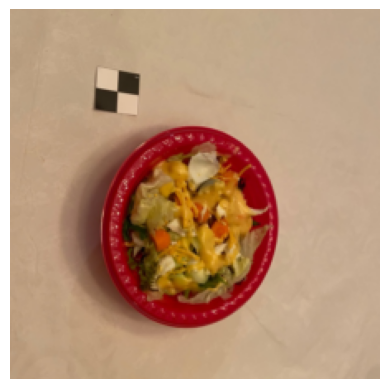


Ingredients:
Ground Truth:  ['Carrots', 'Honey mustard dressing', 'Cucumber', 'Cheese', 'Mixed salad greens', 'Chickpeas']
Inversecooking Prediction:  pepper, onion, oil, salt, cauliflower, carrot
im2recipe Prediction:  Lettuce, Vinegar, Olive oil, Eggplant, Cheese, Peppers, Bread, Garlic


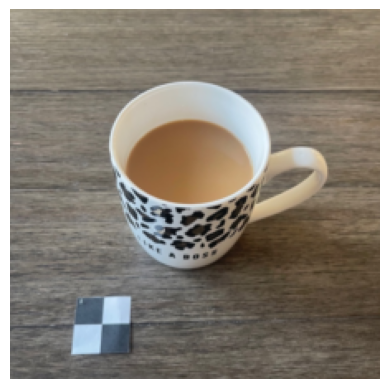


Ingredients:
Ground Truth:  ['Coffee']
Inversecooking Prediction:  water, tea, sugar
im2recipe Prediction:  Cranberry juice drink, Carbonated water


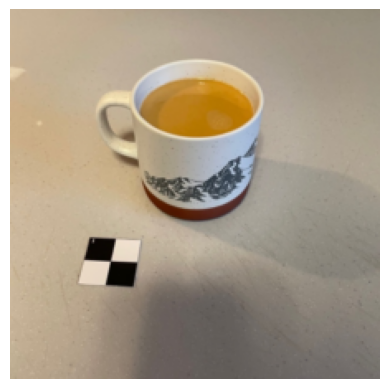


Ingredients:
Ground Truth:  ['Cream', 'Coffee']
Inversecooking Prediction:  water, tea, sugar
im2recipe Prediction:  Carbonated water, Cranberry juice


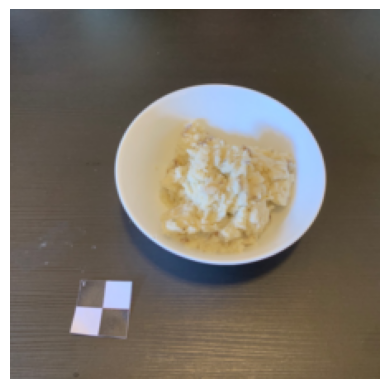


Ingredients:
Ground Truth:  ['Potato']
Inversecooking Prediction:  sugar, milk, egg, salt
im2recipe Prediction:  Cheese, Topping


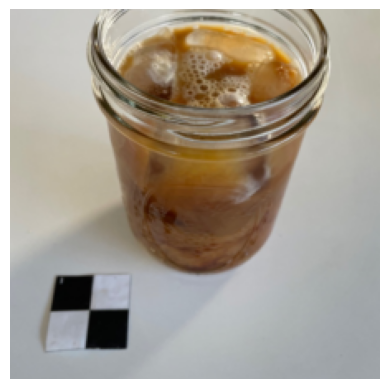


Ingredients:
Ground Truth:  ['Cream', 'Coffee']
Inversecooking Prediction:  sugar, cinnamon, apple, water
im2recipe Prediction:  Apple cider


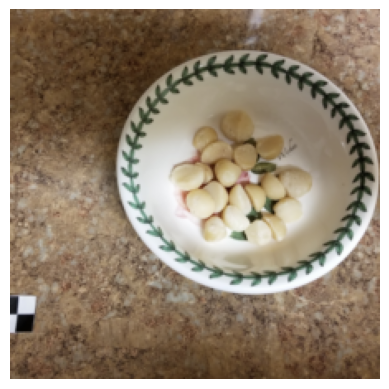


Ingredients:
Ground Truth:  ['Macadamia nuts']
Inversecooking Prediction:  sugar, flour, butter, salt, egg
im2recipe Prediction:  Chicken or turkey broth (replaced with ['chicken_broth'])


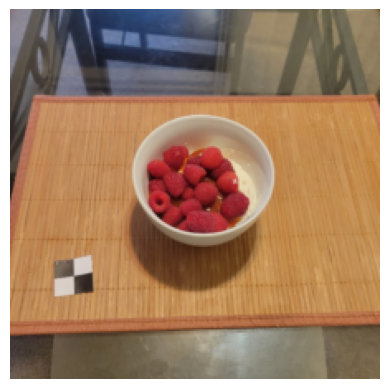


Ingredients:
Ground Truth:  ['Yogurt', 'Jam', 'Raspberries']
Inversecooking Prediction:  sugar, raspberries, water, gelatin, cream
im2recipe Prediction:  Cranberry juice


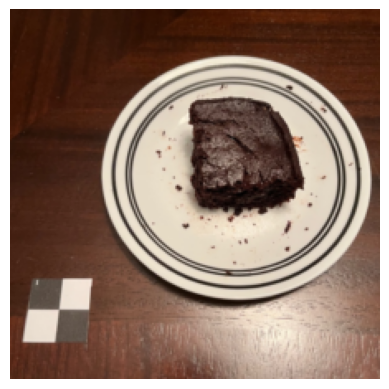


Ingredients:
Ground Truth:  ['Chocolate', 'Butter', 'Salt', 'Baking powder', 'Sugar', 'Egg', 'Quinoa', 'Baking soda', 'Milk', 'Vanilla extract', 'Cocoa powder']
Inversecooking Prediction:  sugar, egg, flour, butter, salt, cocoa, extract, baking_powder, vanilla, chocolate
im2recipe Prediction:  Hot chocolate / Cocoa (replaced with ['cocoa'])


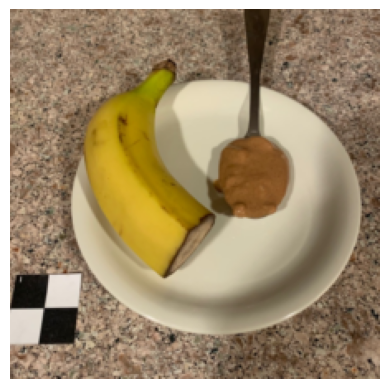


Ingredients:
Ground Truth:  ['Banana', 'Peanut butter']
Inversecooking Prediction:  milk, banana
im2recipe Prediction:  Ice cream cone
======== 90 th iteration====


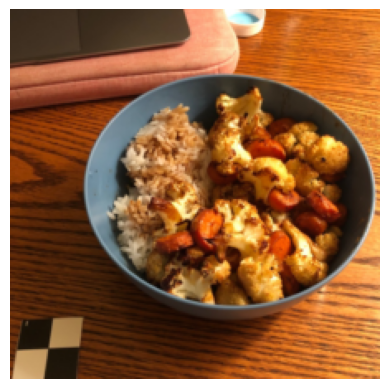


Ingredients:
Ground Truth:  ['Soy sauce', 'Rice', 'Cauliflower', 'Carrots']
Inversecooking Prediction:  oil, pepper, shrimp, salt, clove, cauliflower, ginger, rice, soy_sauce, sugar
im2recipe Prediction:  Chicken curry (replaced with ['chicken', 'curry']), Tomato catsup, Vegetables, Yellow rice


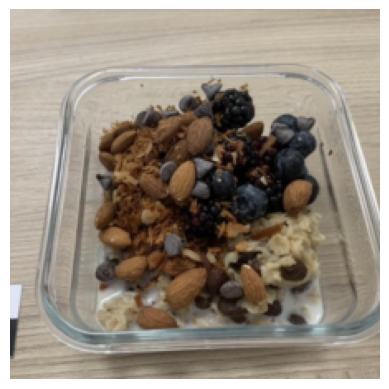


Ingredients:
Ground Truth:  ['Chocolate', 'Raisins', 'Coconut', 'Oatmeal', 'Almonds', 'Blackberries', 'Blueberries', 'Chia seeds']
Inversecooking Prediction:  oats, blueberries, banana, almonds, honey, coconut, seeds
im2recipe Prediction:  Trail mix with chocolate (replaced with ['chocolate', 'trail_mix'])


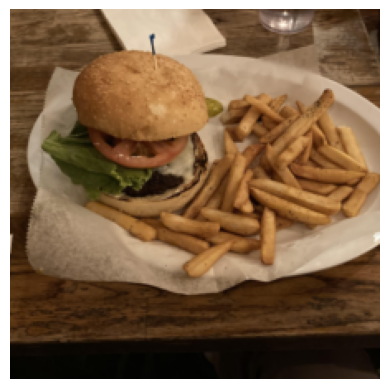


Ingredients:
Ground Truth:  ['Ground beef patty', 'Lettuce', 'Tomatoes', 'Cheese', 'Roll', 'Avocado', 'Onions', 'Potato', 'Mayonnaise']
Inversecooking Prediction:  pepper, bun, onion, cheese, beef, salt, lettuce
im2recipe Prediction:  Salad dressing, Bread stuffing, Olive oil, Alfalfa sprouts, Egg, Romaine lettuce, Mixed salad greens, Mayonnaise


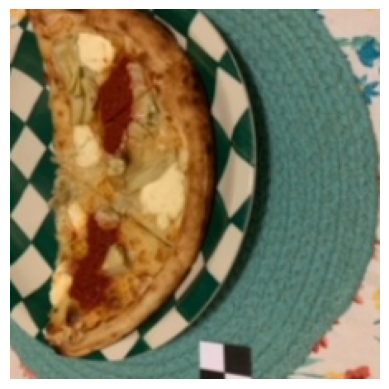


Ingredients:
Ground Truth:  ['Pizza']
Inversecooking Prediction:  egg, cheese, onion, pepper, flour, salt, milk, oil
im2recipe Prediction:  Yogurt, Grapes, Snowpeas, Carrots


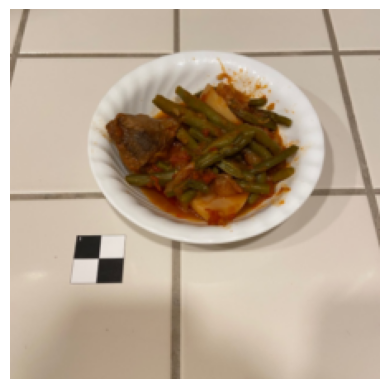


Ingredients:
Ground Truth:  ['Spaghetti sauce', 'Beans', 'Beef', 'Potato']
Inversecooking Prediction:  onion, pepper, oil, beans, clove, tomato, salt
im2recipe Prediction:  Edamame, Sunflower seeds, Vinegar, Olive oil, Pumpkin seeds, Tomatoes, Spinach


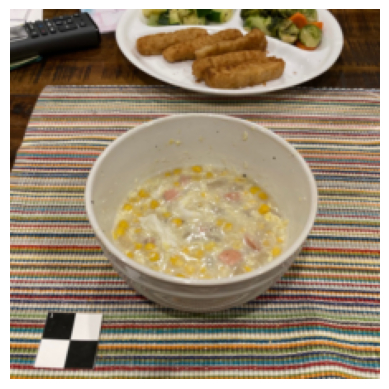


Ingredients:
Ground Truth:  ['Corn soup']
Inversecooking Prediction:  corn, pepper, onion, potato, salt, milk, cream, flour
im2recipe Prediction:  Chicken breast, Corn, White beans, Red kidney beans, Peppers, Onions, Chicken or turkey broth (replaced with ['chicken_broth']), Garlic


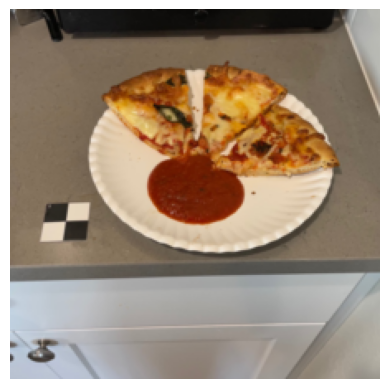


Ingredients:
Ground Truth:  ['Spaghetti sauce', 'Pizza']
Inversecooking Prediction:  cheese, pizza_sauce, pepperoni, oil, basil, pepper
im2recipe Prediction:  Pizza with pepperoni (replaced with ['pizza', 'pepperoni'])


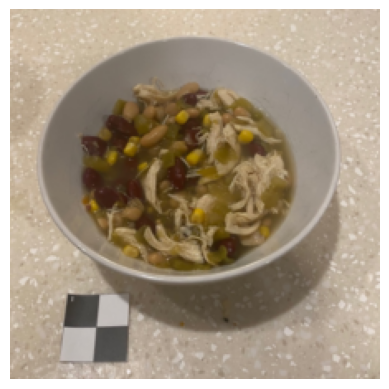


Ingredients:
Ground Truth:  ['Chicken breast', 'Corn', 'White beans', 'Red kidney beans', 'Peppers', 'Onions', 'Chicken or turkey broth', 'Garlic']
Inversecooking Prediction:  onion, pepper, corn, oil, chicken, salt, broth, clove
im2recipe Prediction:  Chicken breast, Corn, White beans, Red kidney beans, Peppers, Onions, Chicken or turkey broth (replaced with ['chicken_broth']), Garlic


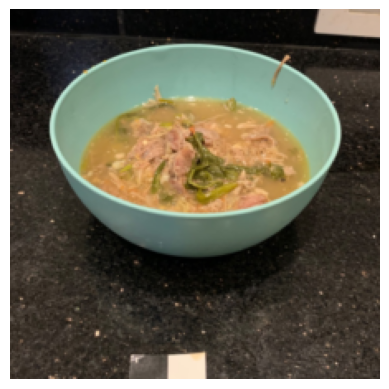


Ingredients:
Ground Truth:  ['Vegetable beef soup']
Inversecooking Prediction:  onion, pepper, oil, chicken, clove, fish, water
im2recipe Prediction:  White beans, Cheese, Onions, Chicken or turkey broth (replaced with ['chicken_broth']), Garlic


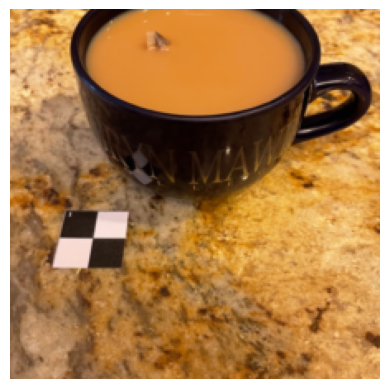


Ingredients:
Ground Truth:  ['Tea', 'Milk']
Inversecooking Prediction:  water, tea, sugar
im2recipe Prediction:  Cereal, Almond milk
======== 100 th iteration====


In [10]:
from utils.output_utils import get_ingrs
import json

with open('../snapme/snapme_data.json', 'r') as f:
    gt = json.load(f)

with open('../snapme/im2ingr_combined.json', 'r') as f:
    im2recipe_pred = json.load(f)

im2ingr = {}
for j, img_file in enumerate(demo_files):
    
    if use_urls:
        response = requests.get(img_file)
        image = Image.open(BytesIO(response.content))
    else:
        image_path = os.path.join(image_folder, img_file)
        try:
            image = Image.open(image_path).convert('RGB')
        except:
            print("*** image load error ***")
            continue
    
    transf_list = []
    transf_list.append(transforms.Resize(256))
    transf_list.append(transforms.CenterCrop(224))
    transform = transforms.Compose(transf_list)
    
    image_transf = transform(image)
    image_tensor = to_input_transf(image_transf).unsqueeze(0).to(device)
    
    plt.imshow(image_transf)
    plt.axis('off')
    plt.show()
    plt.close()
    
    num_valid = 1
    numgens = 1 ##
    for i in range(numgens):
        with torch.no_grad():
            outputs = model.sample(image_tensor, greedy=greedy[i], 
                                   temperature=temperature, beam=beam[i], true_ingrs=None)
            
        ingr_ids = outputs['ingr_ids'].cpu().numpy()
        gen_ingrs = get_ingrs(ingr_ids[0], ingrs_vocab)

        BOLD = '\033[1m'
        END = '\033[0m'
        print(BOLD + '\nIngredients:'+ END)
        print("Ground Truth: ", gt[img_file.split('.')[0]])
        print("Inversecooking Prediction: ", ', '.join(gen_ingrs))
        print("im2recipe Prediction: ", im2recipe_pred[img_file.split('.')[0]]['im2recipe_pred'])
        print('='*20)

        ingr_str = ', '.join(gen_ingrs)
        img_id = img_file
        im2ingr[img_id] = ingr_str
    
    if j%10 == 0:
        print('========', j, 'th iteration====')
    if j==100:
        break

# with open('../snapme/im2ingr_result.json', 'w') as f:
#     json.dump(im2ingr, f)

        # recipe_ids = outputs['recipe_ids'].cpu().numpy()
            
        # outs, valid = prepare_output(recipe_ids[0], ingr_ids[0], ingrs_vocab, vocab)
        
        # if valid['is_valid'] or show_anyways:
            
        #     print ('RECIPE', num_valid)
        #     num_valid+=1
        #     #print ("greedy:", greedy[i], "beam:", beam[i])
    
        #     BOLD = '\033[1m'
        #     END = '\033[0m'
        #     print (BOLD + '\nTitle:' + END,outs['title'])

        #     print (BOLD + '\nIngredients:'+ END)
        #     print (', '.join(outs['ingrs']))

        #     print (BOLD + '\nInstructions:'+END)
        #     print ('-'+'\n-'.join(outs['recipe']))

        #     print ('='*20)

        # else:
        #     pass
        #     print ("Not a valid recipe!")
        #     print ("Reason: ", valid['reason'])


        

In [ ]:
ingrs_vocab

In [37]:
from collections import defaultdict

with open('/home/donghee/inversecooking/snapme/snapme_data.json', 'r') as f:
    gt = json.load(f)

with open('/home/donghee/inversecooking/snapme/im2ingr_result.json', 'r') as f:
    gen_ingr = json.load(f)

im2ingr = defaultdict(dict)

In [38]:
for img_id, ingr in gen_ingr.items():
    img_id = img_id.split('.')[0]
    im2ingr[img_id]['GT'] = ', '.join(gt[img_id])
    im2ingr[img_id]['prediction'] = ingr

# with open('../snapme/im2ingr.json', 'w') as f:
#     json.dump(im2ingr, f, indent = 4)

In [22]:
from collections import Counter

ingr_list = gt.values()

flat_ingr = [ingr for ingrs in ingr_list for ingr in ingrs]
counter_data = Counter(flat_ingr)

print(counter_data)
# ingrs_count = Counter(*gt.values())
# print(ingrs_count)



Counter({'Cheese': 198, 'Coffee': 132, 'Bread': 112, 'Onions': 111, 'Milk': 100, 'Rice': 100, 'Egg': 89, 'Tomatoes': 87, 'Carrots': 74, 'Butter': 65, 'Potato': 64, 'Egg omelet or scrambled egg': 61, 'Banana': 60, 'Spinach': 58, 'Tea': 56, 'Olive oil': 53, 'Avocado': 52, 'Garlic': 50, 'Mushrooms': 49, 'Apple': 49, 'Sugar': 47, 'Lettuce': 46, 'Yogurt': 45, 'Chicken breast': 42, 'Peanut butter': 40, 'Broccoli': 36, 'Peppers': 36, 'Pepper': 34, 'Blueberries': 33, 'Coffee creamer': 33, 'Cucumber': 32, 'Oatmeal': 32, 'Squash': 32, 'Italian dressing': 30, 'Almond milk': 30, 'Salsa': 30, 'Soy sauce': 30, 'Cabbage': 29, 'Water': 29, 'Cream': 29, 'Cookie': 28, 'Romaine lettuce': 27, 'Mixed salad greens': 25, 'Cereal': 25, 'Crackers': 24, 'Pasta': 24, 'Tortilla': 23, 'Salmon': 23, 'Corn': 23, 'Chicken or turkey broth': 22, 'Mayonnaise': 22, 'Roll': 21, 'Grapes': 21, 'Raspberries': 21, 'Tangerine': 20, 'Maple syrup': 20, 'Sweet potato': 20, 'Strawberries': 19, 'Wine': 19, 'Chicken': 18, 'Turkey': 

In [46]:
print(len(counter_data.keys()))

522


In [48]:
with open('../snapme/snapme_counter.json', 'w') as f:
    json.dump(counter_data, f, indent=4)

In [ ]:
sorted_ingr = counter_data.most_common()
# sorted_ingr = [ingr[0] for ingr in sorted_ingr]
print(sorted_ingr)

In [67]:
import fuzzywuzzy
from fuzzywuzzy import process

exist_ingr = []
nonexist_ingr = []
match_pair = {}
for ingr in counter_data.keys():
    ingr = ingr.lower().replace(' ', '_')
    if ingr in ingrs_vocab:
        exist_ingr.append(ingr)
    else:
        threshold = 90
        match = process.extractOne(ingr, ingrs_vocab, scorer = fuzzywuzzy.fuzz.token_set_ratio, score_cutoff = threshold)
        if match:
            match_pair[ingr] = match[0] ## ingr to replaced_ingr(similar one)
            exist_ingr.append(ingr)
        else:
            nonexist_ingr.append(ingr)

print(len(exist_ingr))
print(len(nonexist_ingr))


209
313


In [71]:
'oil' in ingrs_vocab

True

In [76]:
print(match_pair)

{'mixed_salad_greens': 'mixed_salad_green', 'crackers': 'cracker', 'mushrooms': 'mushroom', 'carrots': 'carrot', 'pretzels': 'pretzel', 'onions': 'onion', 'dumpling': 'dumplings', 'peppers': 'pepper', 'oyster-flavored_sauce': 'oyster', 'croutons': 'crouton', 'pancakes': 'pancake', 'chocolate-flavored_sprinkles': 'chocolate', 'olives': 'olive', 'brussels_sprouts': 'brussels_sprout', 'pickles': 'pickle', "reese's_peanut_butter_cup": "reese's_peanut_butter_cups", 'shallots': 'shallot', 'ginger_root': 'gingerroot', 'soy_milk': 'soymilk', 'jello_(gelatin)_powder': 'gelatin', 'meat_loaf': 'meatloaf', 'mayonnaise-type_salad_dressing': 'mayonnaise', 'parsnips': 'parsnip', 'scone': 'scones', 'meatball': 'meatballs', 'bread_crumbs': 'breadcrumbs'}


 ## SNAPMe ingredient replacement... (313개)

In [ ]:
replaced_ingr = {}

for miss_ingr in nonexist_ingr:
    replaced = input("{}: ".format(miss_ingr))
    replaced_ingr[miss_ingr] = replaced

with open('../snapme/miss2replace.json', 'w') as f:
    json.dump(replaced_ingr, f, indent = 4)

In [10]:
import json
from collections import defaultdict

with open('../snapme/im2ingr.json', 'r') as f:
    inverse = json.load(f)

with open('../snapme/im2recipe_result.json', 'r') as f:
    im2recipe = json.load(f)

combined = defaultdict(dict)

for img_id, gt_pred in inverse.items():
    gt = gt_pred['GT']
    inverse_predict = gt_pred['prediction']
    im2recipe_predict = ', '.join(im2recipe[img_id]['top1'])
    combined[img_id]['GT'] = gt
    combined[img_id]['inverse_pred'] = inverse_predict
    combined[img_id]['im2recipe_pred'] = im2recipe_predict

with open('../snapme/im2ingr_combined.json', 'w') as f:
    json.dump(combined, f, indent = 4)